# Working example of SeisMonitoring.jl

This notebook conducts the processing of ambient seismic noise using the Julia-based software [SeisMonitoring.jl](https://github.com/kura-okubo/SeisMonitoring.jl).

# Installation

## How to run this notebook
We have two options to run this notebook.

### Run using the docker container
We first recommend using the docker container, which does not contaminate your environment in the local machine.

To run this notebook using docker,

1. **Install the docker engine on your machine.**

    <a href="https://docs.docker.com/engine/install" target="_blank">See the official documentation for the installation.</a> The Docker Desktop is useful in general machines like Windows, Linux, and Mac OS. We developed this notebook using MacOS with both M1 and Intel chips.

   The required docker resources are the following:

   |     |     |
   | --- | --- |
   | CPUs | >=1 |
   | Memory | > 4GB |
   | Swap | > 1GB |
   | Disk image size | > 8GB |

   You can configure them in the `settings` of the Docker Desktop.
   
3. **Launch the docker engine.**

   Type `docker ps` in the terminal to check if the docker command works.
   if you get the error like `Cannot connect to the Docker daemon at unix:///var/run/docker.sock. Is the docker daemon running?`,
   the docker engine is not likely to be ready. Check the status of Docker desktop.

4. **Download the example repository, and build the docker container.**

   Type the commands below to build the docker container in your machine.

    ```bash
    git clone https://github.com/kura-okubo/SeisMonitoring_Example
    cd SeisMonitoring_Example
    docker compose up -d


    ```

   The JupyterLab server automatically starts in the container when you start it following the description written in `docker-compose.yml`. Type
   ```
   docker compose ps

   
   ```
   and if the container is successfully started, it returns as follows:
   ```
   NAME                SERVICE             STATUS              PORTS
   seismonitoring      seismonitoring      running             0.0.0.0:8888->8888/tcp

   
   ```

5. **Launch the JupyterLab in your web browser.**
  
    Go to <a href="http://localhost:8888" target="_blank">http://localhost:8888</a> with your browser (e.g. Google Chrome) or type `open http://127.0.0.1:8888` in your terminal to open the JupyterLab. If succeeded, you will find the Launcher of the kernels.

    <img src="./JupyterLab_seismonitoring.jpg" alt="JupyterLab_seismonitoring.jpg" width="550px"/>
    
    Go to the `code` directory, and open `run_seismonitoring.ipynb`.

#### Key commands for Docker users
Here are some useful commands to manage the docker container. <br>You can execute these commands **in the working directory where `docker-compose.yml` is located.**

|     |     |
| --- | --- |
|`docker compose up -d`| Build and start the docker service named as `seismonitoring`. `-d` is the detach mode to run the service in background|
|`docker compose ps`| Show the status of docker service.|
|`docker compose exec seismonitoring /bin/bash`| Login to enter the docker container. | 
|`open http://127.0.0.1:8888`| After running the docker service, you can open the jupyterlab with the browser of localhost.|
|`docker compose stop`| Stop the docker container.|
|`docker compose start seismonitoring`| Start the docker container.|
|`docker compose restart`| Restart the docker container.|
|`docker compose down`| Remove the container <br> **Caution:** This command removes the installed Julia packages, i.e. you need to redownload them from the beginning. Use `docker compose stop` if you just want to pause the docker container.|


### Run in your own environment

You can run this notebook by installing Julia in your local environment instead of using the docker container.

Try the following steps:

1. **Download the example repository**

   Download the example repository from GitHub as follows:

    ```bash
    git clone https://github.com/kura-okubo/SeisMonitoring_Example
    cd SeisMonitoring_Example

    
    ```    
2. **Download Julia in your machine.**

   We developed and conducted the `SeisMonitoring.jl` using the **Julia v1.7.3**. The later version of Julia could be compatible, while we recommend using this Julia version to run the notebooks.

   You can download the Julia from the official website (https://julialang.org/downloads/oldreleases/).
   
   After installing the Julia, launch the [Julia REPL](https://docs.julialang.org/en/v1/stdlib/REPL/) by executing e.g. `/Applications/Julia-1.7.app/Contents/Resources/julia/bin/julia`. You will find the logo in the terminal as follows:

   ```
       _       _ _(_)_     |  Documentation: https://docs.julialang.org
      (_)     | (_) (_)    |
       _ _   _| |_  __ _   |  Type "?" for help, "]?" for Pkg help.
      | | | | | | |/ _` |  |
      | | |_| | | | (_| |  |  Version 1.7.3 (2022-05-06)
     _/ |\__'_|_|_|\__'_|  |  Official https://julialang.org/ release
    |__/                   |

    julia>

   
    ```

3. **Install IJulia.jl**

   To launch the JupyterLab with the Julia kernel, you need to install the [IJulia](https://github.com/JuliaLang/IJulia.jl).

   Type
   ```
   import Pkg; Pkg.add("IJulia")

   
   ```

   to download and install the package. Note that the package is located in `~/.julia/packages`. Then, type

   ```
   import IJulia
   IJulia.jupyterlab(dir=pwd())

   
   ```
   You are asked to install Jupyter such as `install Jupyter via Conda, y/n? [y]:`, so type `y` to install it.

   After installing Jupyter, it opens JupyterLab Launcher in your browser.<br>
   **Tips:** You can launch the JupyterLab by the bash command such as

   ```
   julia -e 'import Pkg; Pkg.add("Conda")'
   `julia -e "import Conda; print(Conda.PREFIX)"`/bin/jupyter lab --NotebookApp.token=''


   ```
   This calls the `jupyter` located in e.g. `/root/.julia/conda/3/x86_64/bin`. We use this metric in the docker-compose to launch the JupyterLab.




### Install Julia packages

After you successfully open the notebook, install the Julia packages associated with the seismic processing into your environment.

**It takes ~15 minutes to download and install the packages, but you need this only the first time you launch the new docker container or your local machine.**

To keep those packages in your container, use `docker compose stop`, not `docker compose down`.

**Warning:** If you use the local Julia environment without the docker container, the installation would fail or it contaminates your environment due to the dependencies. 

We install the following Julia packages:
|     |     |
| --- | --- |
| [SeisIO.jl](https://github.com/jpjones76/SeisIO.jl) | The kernel to handle the seismic waveforms |
| [SeisNoise.jl](https://github.com/tclements/SeisNoise.jl) | Compute noise cross-correlations |
| [SeisDvv.jl](https://github.com/tclements/SeisDvv.jl)| Measure dv/v |
| [SeisMonitoring.jl](https://github.com/kura-okubo/SeisMonitoring.jl) | Processing noise from downloading to the measurement of dv/v |

Run the following cell to install the packages listed above.

In [1]:
using Pkg
Pkg.add(PackageSpec(name="SeisIO", version="1.2.1"));
Pkg.add(PackageSpec(name="SeisNoise", version="0.5.3"));
Pkg.add(url="https://github.com/tclements/SeisDvv.jl");
Pkg.add(url="https://github.com/kura-okubo/SeisMonitoring.jl");

# Add some more basic packages
Pkg.add(["Plots", "JLD2", "DataStructures"])

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.7/Project.toml`
  No Changes to `~/.julia/environments/v1.7/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.7/Project.toml`
  No Changes to `~/.julia/environments/v1.7/Manifest.toml`
    Updating git-repo `https://github.com/tclements/SeisDvv.jl`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.7/Project.toml`
  No Changes to `~/.julia/environments/v1.7/Manifest.toml`
    Updating git-repo `https://github.com/kura-okubo/SeisMonitoring.jl`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.7/Project.toml`
  No Changes to `~/.julia/environments/v1.7/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.7/Project.toml`
  No Changes to `~/.julia/environments/v1.7/Manifest.toml`


# Workflow of this notebook

We perform the following processings step by step:

0. Initiate the project
1. Download the data
2. Remove transient signals
3. Compute cross-correlation
4. Stacking the correlation functions and evaluate dv/v

**NOTE:** We already prepared the data of cross-correlation functions to conduct `4. stacking the correlation function and evaluate dv/v` as we demonstrate the stacks of the correlation functions over 20 years in this notebook. We need computational resources,  e.g. a minimum of 48 cores of workstation and enough storage, to compute the number of correlations within a reasonable computational time.

# 0. Initiate the project

We first initialize the project to make the directories for the output files.

**NOTE:** All the parameters used for the processing is managed in `mainparam.jl`. You can modify it with either the function of `set_parameter()` or directory editing the file using text editor.

In [2]:
# Import packages to be used in this notebook
using SeisIO, SeisNoise, SeisMonitoring, Plots, JLD2, Downloads, Distributed

In [3]:
?set_parameter

search: set_parameter



```
set_parameter(inputfilename::String, key::String, value::String)
```

Set parameter of input dictionary in the inputfile.


In [4]:
project_name = "run_seismonitoring_demo"
project_inputdir="/root/data"
project_outputdir="/root/data"

master_param="/root/code/mainparam_master.jl"

"/root/code/mainparam_master.jl"

In [5]:
# make default input and output directory
init_project(project_name=project_name,
             project_inputdir=project_inputdir,
             project_outputdir=project_outputdir,
             force=false, gui=false 
            )

┌ Error: The project input directory already exists. Please make another project, or remove old project.
└ @ SeisMonitoring ~/.julia/packages/SeisMonitoring/QLCnH/src/Utils/init_project.jl:69


In [6]:
# make request station list
fipath = "/root/code/BP_gmap-stations_example.txt"

locchan = Dict(
            "BP" => [("*", "SP*")]
            )

station_fodir = project_outputdir*"/$(project_name)_OUTPUT"
station_path = make_requeststation_fromIRISgmap(fipath, locchan=locchan, fodir=station_fodir, foname="$(project_name).jld2")

# copy master parameter file into project directory
fo_mainparam = project_inputdir*"/$(project_name)_INPUT/mainparam.jl"
~isfile(fo_mainparam) && cp(master_param, fo_mainparam)

# replace parameters for casestudy
set_parameter(fo_mainparam, "project_name", project_name)
set_parameter(fo_mainparam, "project_inputdir", project_inputdir*"/$(project_name)_INPUT")
set_parameter(fo_mainparam, "project_outputdir", project_outputdir*"/$(project_name)_OUTPUT")
set_parameter(fo_mainparam, "requeststation_file",  station_fodir*"/$(project_name).jld2")

In [7]:
# Check the main parameters
# load the dictionary of mainparam.jl
PARAM = include("/root/data/run_seismonitoring_demo_INPUT/mainparam.jl")

OrderedDict{String, Tuple{String, DataType, String}} with 92 entries:
  "project_name"         => ("run_seismonitoring_demo", String, "project name.")
  "project_inputdir"     => ("/root/data/run_seismonitoring_demo_INPUT", String…
  "project_outputdir"    => ("/root/data/run_seismonitoring_demo_OUTPUT", Strin…
  "starttime"            => ("2016-01-15T00:00:00", DateTime, "process start ti…
  "endtime"              => ("2016-01-17T00:00:00", DateTime, "process end time…
  "sampling_frequency"   => ("20", Float64, "[Hz] Processing sampling frequency…
  "freqency_band"        => ("0.2, 0.5, 0.9, 1.2, 2.0", Float64, "Frequency ban…
  "MAX_MEM_USE"          => ("3.0", Float64, "[GB] Maximum memory use per core …
  "download_time_unit"   => ("86400", Int64, "[s] Unit time of data request. (e…
  "download_margin"      => ("300", Int64, "[s] Download margin to be clipped t…
  "requeststation_file"  => ("/root/data/run_seismonitoring_demo_OUTPUT/run_sei…
  "IsResponseRemove"     => ("true", Bo

## Assign the number of processors for parallelization
All the processing stages are parallelized with the `pmap` function.
You can increase the number of cores by `Distributed.addprocs()` to conduct the parallel processing.

**NOTE:** We need to add at least one processor as the worker for the `pmap` parallelization.
**Tips:** The number of `nprocs` is not linked to the physical number of cores. However, you need the cores more than the `nprocs` to optimize the performance of parallelization. 

In [8]:
print("Before adding the procs: NP=$(nprocs())\n");
NP = 1 # >= 1, number of additional processors; for docker users, the maximum number is managed in the docker configuration.
addprocs(NP) 
print("After adding the procs: NP=$(nprocs())");
# You need to redefine the packages in all the processors.
@everywhere using SeisMonitoring


Before adding the procs: NP=1
After adding the procs: NP=2

# 1. Download the data

We demonstrate to download the data from the data server. In this notebook, we download the 3 days of the continuous wavefrom associated with the station `EADB` in the High Resolution Seismic Network (HRSN) operated by the Berkeley Seismological Laboratory from the [Northern California Earthquake Data Center](https://ncedc.org/).

**Data Citation:**
"HRSN (2014), High Resolution Seismic Network. UC Berkeley Seismological Laboratory. Dataset. doi:[10.7932/HRSN](https://ncedc.org/hrsn/hrsn.overview.html)."

**Warning:** Do NOT download the data with a large number of parallelization (i.e. large number of `nprocs`); which causes issues in the data server.

In [9]:
# Show the station list to download the data. The structure of JLD2 is ["SERVER"/"STATIONTABLE"]
t = jldopen("/root/data/run_seismonitoring_demo_OUTPUT/run_seismonitoring_demo.jld2", "r")
@show t["NCEDC"]
close(t)

t["NCEDC"] = 1×10 DataFrame
 Row │ network  station  location  channel  latitude  longitude   elevation  sitename                        starttime            endtime
     │ String   String   String    String   String    String      String     String                          DateTime             DateTime
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │ BP       EADB     *         SP*      35.89522  -120.42262  469.0      Eade Ranch, Parkfield, CA, USA  2000-11-25T00:00:00  3000-01-01T00:00:00


In [10]:
# For the demonstration, we limit the number of station and time chuncks
set_parameter(fo_mainparam, "starttime", "2016-01-15T00:00:00")
set_parameter(fo_mainparam, "endtime", "2016-01-17T00:00:00")

`SeisMonitoring.run_job()` is the function to run the processing. You can run all the processes with a single job by turning on the options.

In this notebook, we run the processes separately for the sake of demonstration.

In [11]:
SeisMonitoring.run_job("/root/data/run_seismonitoring_demo_INPUT/mainparam.jl", 
        run_seisdownload=true,
        run_seisremoveeq=false,
        run_seisxcorrelation=false,
        run_seisstack=false)



*************************************************************************************
  _____        _       __  __                _  _                _
 / ____|      (_)     |  \/  |              (_)| |              (_)
| (___    ___  _  ___ | \  / |  ___   _ __   _ | |_  ___   _ __  _  _ __    __ _
 \___ \  / _ \| |/ __|| |\/| | / _ \ | '_ \ | || __|/ _ \ | '__|| || '_ \  / _` |
 ____) ||  __/| |\__ \| |  | || (_) || | | || || |_| (_) || |   | || | | || (_| |
|_____/  \___||_||___/|_|  |_| \___/ |_| |_||_| \__|\___/ |_|   |_||_| |_| \__, |
                                                                            __/ |
                                                                           |___/

v0.0.2 (Last update: 2020-08-19) © Kurama Okubo
*************************************************************************************

Job start running at 2023-08-16T20:15:42


input file: /root/data/run_seismonitoring_demo_INPUT/mainparam.jl

***************************************
s

The seismic data is stored in the structure of `SeisIO.SeisChannel` in the SeisIO native binary format.
Lets's check the seismic trace.

In [12]:
finame="/root/data/run_seismonitoring_demo_OUTPUT/seismicdata/rawseismicdata/BP.EADB.40.SP1/2016/BP.EADB.40.SP1__2016-01-15T00:00:00__2016-01-16T00:00:00__sp1.seisio"
S0 = rseis(finame)[1]
S0

SeisChannel with 1728001 samples
    ID: BP.EADB.40.SP1
  NAME: Eade Ranch, Parkfield, CA, USA
   LOC: 35.8952 N, -120.423 E, 224.0 m
    FS: 20.0
  GAIN: 1.0
  RESP: a0 1.0, f0 1.0, 1z, 1p
 UNITS: m/s
   SRC: https://service.ncedc.org/fdsnws/dataselect/1/query
  MISC: 6 entries
 NOTES: 10 entries
     T: 2016-01-15T00:00:00 (0 gaps)        
     X: +7.267e-07                          
        +6.724e-07                          
            ...                             
        -1.008e-06                          
        (nx = 1728001)                      

In [13]:
starttime = u2d.(S0.t[1, 2]*1e-6)
nx = S0.t[2, 1]
tvec = collect(0:1/S0.fs:length(S0.x)/S0.fs)
tvec_date = u2d.(tvec .+ S0.t[1,2]*1e-6);

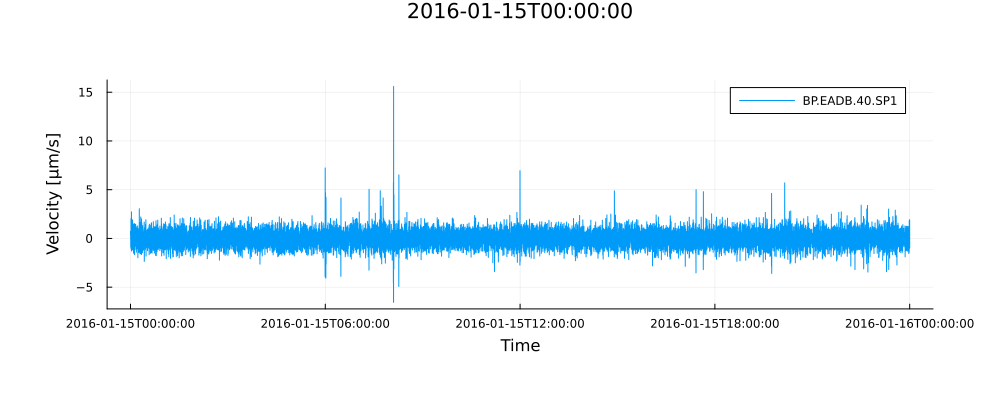

In [14]:
plotspan=100 # skip some points to speed up the plotting

p1=plot(tvec_date[1:plotspan:end], S0.x[1:plotspan:end].*1e6, title="$starttime", 
    xlabel="Time", ylabel="Velocity [µm/s]", label="$(S0.id)", size=(1000,400), margin=15Plots.mm)

**NOTE:** It takes a little bit long time to plot the figure for the first time because of the dynamic compilation, but you will find it much faster for second time as the module has been compiled. 

# 2. Remove the transient signals; earthquakes and tremors

In [15]:
set_parameter(fo_mainparam, "Append_alltraces", "true") # save all the intermediate traces during the removal of earthquake and tremors.

In [16]:
SeisMonitoring.run_job("/root/data/run_seismonitoring_demo_INPUT/mainparam.jl", 
        run_seisdownload=false,
        run_seisremoveeq=true,
        run_seisxcorrelation=false,
        run_seisstack=false)



*************************************************************************************
  _____        _       __  __                _  _                _
 / ____|      (_)     |  \/  |              (_)| |              (_)
| (___    ___  _  ___ | \  / |  ___   _ __   _ | |_  ___   _ __  _  _ __    __ _
 \___ \  / _ \| |/ __|| |\/| | / _ \ | '_ \ | || __|/ _ \ | '__|| || '_ \  / _` |
 ____) ||  __/| |\__ \| |  | || (_) || | | || || |_| (_) || |   | || | | || (_| |
|_____/  \___||_||___/|_|  |_| \___/ |_| |_||_| \__|\___/ |_|   |_||_| |_| \__, |
                                                                            __/ |
                                                                           |___/

v0.0.2 (Last update: 2020-08-19) © Kurama Okubo
*************************************************************************************

Job start running at 2023-08-16T20:18:17


input file: /root/data/run_seismonitoring_demo_INPUT/mainparam.jl

***************************************
s

In [17]:
#Let's check the result of the removal of earthquakes and tremors
t = jldopen("/root/data/run_seismonitoring_demo_OUTPUT/seismicdata/seisremoveeq/BP.EADB.40.SP1__2016-01-15T00:00:00__2016-01-16T00:00:00__sp1.seisio.jld2", "r")
S1 = t["S"]
close(t)

In [18]:
plotspan = 100
kurtosis_plotspan=60*20 # kurtosis is computed every 60 second * 20Hz 
trace_ylim = (-12, 12)

kurtosis_threshold=parse(PARAM["kurtosis_threshold"][2], PARAM["kurtosis_threshold"][1]) 
stalta_threshold=parse(PARAM["stalta_threshold"][2], PARAM["stalta_threshold"][1]) 

ticks = tvec_date[1]:Hour(6):tvec_date[end]

tvec = collect(0:1/S1.fs:(length(S1.x)-1)/S1.fs)
tvec_date = u2d.(tvec .+ S1.t[1,2]*1e-6)
p1=plot(tvec_date, S1.misc["raw_trace"]*1e6, color=:black,xformatter=_->"",  label="", ylabel="µm/s")
p1=plot!(p1,xformatter=_->"", title = "(a)", titleloc = :left, titlefont = font(10), ylim=trace_ylim)
p2=plot(tvec_date[kurtosis_plotspan:kurtosis_plotspan:end], S1.misc["kurtsis_trace"][kurtosis_plotspan:kurtosis_plotspan:end], color=:blue, xformatter=_->"",  label="", ylabel="kurtosis")
p2=hline!(p2, [kurtosis_threshold], label="", xformatter=_->"", title = "(b)", titleloc = :left, titlefont = font(10))
p3=plot(tvec_date[1:plotspan:end], S1.misc["stalta_trace"][1:plotspan:end], color=:green, xformatter=_->"", label="", ylabel="STA/LTA")
p3=hline!(p3, [stalta_threshold], label="", xformatter=_->"", title = "(c)", titleloc = :left, titlefont = font(10))
p4=plot(tvec_date[1:plotspan:end], S1.x[1:plotspan:end]*1e6, color=:red, xformatter=_->"", label="", ylabel="µm/s")
p4 = plot!(title = "(d)", titleloc = :left, titlefont = font(10), ylim=trace_ylim)

# plot all
plot(p1, p2, p3, p4, layout=(4, 1), link=:x, xticks=ticks)
plot!(size=(1000,800), right_margin=10Plots.mm)

In [19]:
# For the cross-correlation, we need to re-run the removal without appending the intermediate traces.
set_parameter(fo_mainparam, "Append_alltraces", "false") # save all the intermediate traces during the removal of earthquake and tremors.
SeisMonitoring.run_job("/root/data/run_seismonitoring_demo_INPUT/mainparam.jl", 
        run_seisdownload=false,
        run_seisremoveeq=true,
        run_seisxcorrelation=false,
        run_seisstack=false)



*************************************************************************************
  _____        _       __  __                _  _                _
 / ____|      (_)     |  \/  |              (_)| |              (_)
| (___    ___  _  ___ | \  / |  ___   _ __   _ | |_  ___   _ __  _  _ __    __ _
 \___ \  / _ \| |/ __|| |\/| | / _ \ | '_ \ | || __|/ _ \ | '__|| || '_ \  / _` |
 ____) ||  __/| |\__ \| |  | || (_) || | | || || |_| (_) || |   | || | | || (_| |
|_____/  \___||_||___/|_|  |_| \___/ |_| |_||_| \__|\___/ |_|   |_||_| |_| \__, |
                                                                            __/ |
                                                                           |___/

v0.0.2 (Last update: 2020-08-19) © Kurama Okubo
*************************************************************************************

Job start running at 2023-08-16T20:19:53


input file: /root/data/run_seismonitoring_demo_INPUT/mainparam.jl

***************************************
s

# 3. Compute cross-correlation

We conduct the cross-correlation associated with the downloaded data. The parameters associated with the correlations such as `cc_len` are described in `/root/data/run_seismonitoring_demo_INPUT/mainparam.jl`. 

**NOTE:** The first run of the cross-correlation takes time due to the compilation of the functions like ~ 5min. Once the functions are compiled, the cross-correlation is optimized in parallel.

In [20]:
set_parameter(fo_mainparam, "IsPreStack", "false") # avoid the prestack of the unit time (e.g. day) to keep all the short-time (e.g. hourly) CFs.

SeisMonitoring.run_job("/root/data/run_seismonitoring_demo_INPUT/mainparam.jl", 
        run_seisdownload=false,
        run_seisremoveeq=false,
        run_seisxcorrelation=true,
        run_seisstack=false)



*************************************************************************************
  _____        _       __  __                _  _                _
 / ____|      (_)     |  \/  |              (_)| |              (_)
| (___    ___  _  ___ | \  / |  ___   _ __   _ | |_  ___   _ __  _  _ __    __ _
 \___ \  / _ \| |/ __|| |\/| | / _ \ | '_ \ | || __|/ _ \ | '__|| || '_ \  / _` |
 ____) ||  __/| |\__ \| |  | || (_) || | | || || |_| (_) || |   | || | | || (_| |
|_____/  \___||_||___/|_|  |_| \___/ |_| |_||_| \__|\___/ |_|   |_||_| |_| \__, |
                                                                            __/ |
                                                                           |___/

v0.0.2 (Last update: 2020-08-19) © Kurama Okubo
*************************************************************************************

Job start running at 2023-08-16T20:20:19


input file: /root/data/run_seismonitoring_demo_INPUT/mainparam.jl

***************************************
s

Let's check the cross-correlation functions; channel correlation of SP1-SP2

The correlation functions are stored as `SeisNoise.CorrData`. The JLD2 file contains the `CorrData` associated with the time chunks and frequency bands.

In [21]:
# Station pair and time chunk to read and plot the CFs
stationpair = ["SP1", "SP2"] # choose from SP1, SP2, SP3
timechunk = "2016-01-16T00:00:00--2016-01-17T00:00:00" 

"2016-01-16T00:00:00--2016-01-17T00:00:00"

In [22]:
t = jldopen("/root/data/run_seismonitoring_demo_OUTPUT/cc/BP.EADB.40.$(stationpair[1])-BP.EADB.40.$(stationpair[2])/BP.EADB.40.$(stationpair[1])-BP.EADB.40.$(stationpair[2])__2016-01-15T00:00:00__2016-01-17T00:00:00.jld2", "r")
t

JLDFile /root/data/run_seismonitoring_demo_OUTPUT/cc/BP.EADB.40.SP1-BP.EADB.40.SP2/BP.EADB.40.SP1-BP.EADB.40.SP2__2016-01-15T00:00:00__2016-01-17T00:00:00.jld2 (read-only)
 ├─📂 2016-01-15T00:00:00--2016-01-16T00:00:00
 │  ├─🔢 0.2-0.5
 │  ├─🔢 0.5-0.9
 │  ├─🔢 0.9-1.2
 │  └─🔢 1.2-2.0
 └─📂 2016-01-16T00:00:00--2016-01-17T00:00:00
    ├─🔢 0.2-0.5
    ├─🔢 0.5-0.9
    ├─🔢 0.9-1.2
    └─🔢 1.2-2.0

In [23]:
# Store the corr data from the JLD2 output.
freqkeys = Vector{String}()
Clist = Vector{CorrData}()
for key in keys(t["2016-01-15T00:00:00--2016-01-16T00:00:00"])
    push!(freqkeys, key)
    push!(Clist, t["$(timechunk)/$(key)"])
end
close(t)

In [24]:
plot_all = []
for i = 1:length(freqkeys)
    push!(plot_all, Plots.plot(Clist[i], title="$(freqkeys[i])Hz"))
end

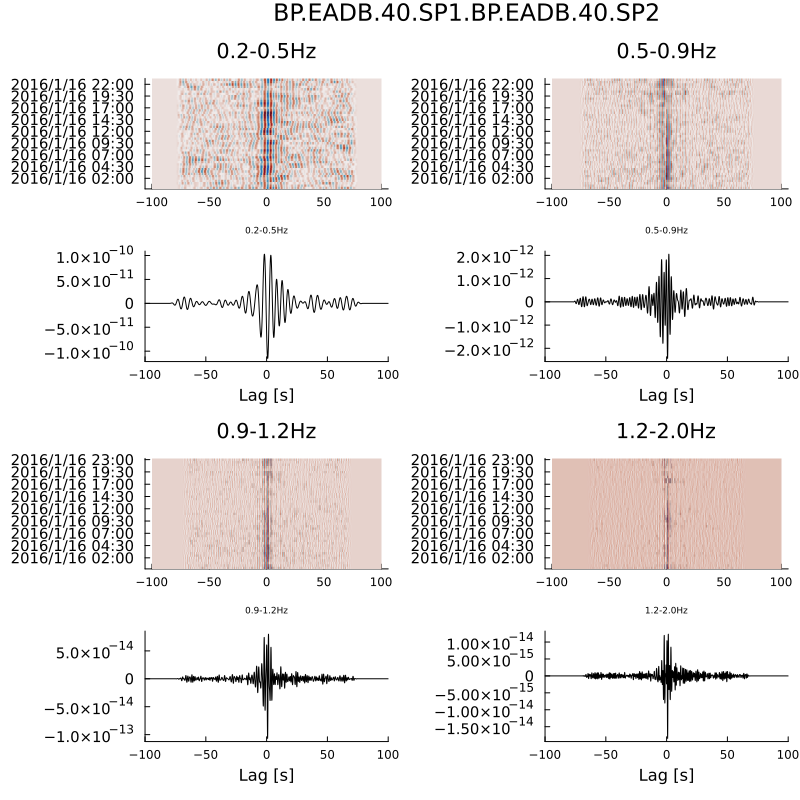

In [25]:
plot(plot_all[1], plot_all[2], plot_all[3], plot_all[4], layout=(2, 2), link=:x, size=(800, 800), plot_title=Clist[1].name)


In [26]:
# time vector of the lag time
tvec_corr = -Clist[1].maxlag:1/(Clist[1].fs):Clist[1].maxlag

-100.0:0.05:100.0

In [27]:
plot_all_wiggle = []

for i = 1:length(freqkeys)
    maxamp = maximum(Clist[i].corr)
    yshift = (0:size(Clist[i].corr, 2)-1) * 1.0 * maxamp
    push!(plot_all_wiggle, Plots.plot(tvec_corr, Clist[i].corr .+ yshift', xlabel="Lags [s]", ylabel="Short-time CFs",
            yticks=false, label="", title="$(freqkeys[i])Hz"))
end

In [28]:
plot(plot_all_wiggle[1], plot_all_wiggle[2], plot_all_wiggle[3], plot_all_wiggle[4],
    layout=(2, 2), link=:x, size=(800, 800), plot_title=Clist[1].name,  margin=5Plots.mm)


You can find the short-time correlation functions with different frequency bands. In practice, we set `IsPreStack` as `true` such that we prestack the short-time CFs as e.g. daily stack for the sake of reducing the output file size. 

## Channel collection of the correlations
Before we move to stack, we collect the output of correlation functions into a single .jld2 file. This is because

1. We parallelized the processes of computing the correlations with the time chunks, and separately output the correlations into the JLD2 files. It is thus efficient to collect them in a single file for stacking. The length of parallelized time chunk is configured by `timechunk_increment` in the `mainparam.jl`. The default is parallelizing every 5 days for all the station pairs, which is taken by a worker.

2. We want to merge the channels between e.g. "BP*" and "SP*". We store those correlation functions in the same file.

In [29]:
set_parameter(fo_mainparam, "stack_RawData_dir", "/root/data/run_seismonitoring_demo_OUTPUT/cc") # collect the stationpair
set_parameter(fo_mainparam, "collect_stationpairs", "true") # collect the stationpair
set_parameter(fo_mainparam, "compute_reference", "false") # compute the reference stack
set_parameter(fo_mainparam, "compute_shorttimestack", "false") # compute the short time (e.g. monthly) stack

SeisMonitoring.run_job("/root/data/run_seismonitoring_demo_INPUT/mainparam.jl", 
        run_seisdownload=false,
        run_seisremoveeq=false,
        run_seisxcorrelation=false,
        run_seisstack=true)



*************************************************************************************
  _____        _       __  __                _  _                _
 / ____|      (_)     |  \/  |              (_)| |              (_)
| (___    ___  _  ___ | \  / |  ___   _ __   _ | |_  ___   _ __  _  _ __    __ _
 \___ \  / _ \| |/ __|| |\/| | / _ \ | '_ \ | || __|/ _ \ | '__|| || '_ \  / _` |
 ____) ||  __/| |\__ \| |  | || (_) || | | || || |_| (_) || |   | || | | || (_| |
|_____/  \___||_||___/|_|  |_| \___/ |_| |_||_| \__|\___/ |_|   |_||_| |_| \__, |
                                                                            __/ |
                                                                           |___/

v0.0.2 (Last update: 2020-08-19) © Kurama Okubo
*************************************************************************************

Job start running at 2023-08-16T20:24:14


input file: /root/data/run_seismonitoring_demo_INPUT/mainparam.jl

***************************************
s

In [30]:
# check the collected correlation functions
staionpairname = "BP.EADB-BP.EADB-11"
t = jldopen("/root/data/run_seismonitoring_demo_OUTPUT/cc_channel_collection/$(staionpairname).jld2")
t

JLDFile /root/data/run_seismonitoring_demo_OUTPUT/cc_channel_collection/BP.EADB-BP.EADB-11.jld2 (read-only)
 ├─📂 2016-01-15T00:00:00--2016-01-16T00:00:00
 │  ├─🔢 0.2-0.5
 │  ├─🔢 0.5-0.9
 │  ├─🔢 0.9-1.2
 │  └─🔢 1.2-2.0
 └─📂 2016-01-16T00:00:00--2016-01-17T00:00:00
    ├─🔢 0.2-0.5
    ├─🔢 0.5-0.9
    ├─🔢 0.9-1.2
    └─🔢 1.2-2.0

# 4. Stacking the correlation functions and evaluate dv/v

In [31]:
ccfiname = "BP.EADB-BP.MMNB-11"
if isfile("/root/data/run_seismonitoring_demo_OUTPUT/cc_channel_collection/$(ccfiname).jld2")
    # error("$(ccfiname) already exists. Please remove it before downloading the cc file." )
end

ccfile_url = "https://www.dropbox.com/scl/fi/0jq597lq9jeo6degz8ugm/$(ccfiname)__0.9-1.2.jld2?rlkey=an8y4h9i9gvvz1s02lh2iln8i&dl=0"
fprog(total,now) = print("$(now/1e6) / $(total/1e6) MB downloaded. \r");flush(stdout)
ccfile_path = Downloads.download(ccfile_url, "/root/data/run_seismonitoring_demo_OUTPUT/cc_channel_collection/$(ccfiname).jld2", progress=fprog )


"/root/data/run_seismonitoring_demo_OUTPUT/cc_channel_collection/BP.EADB-BP.MMNB-11.jld2"

In [32]:
t = jldopen(ccfile_path, "r")

JLDFile /root/data/run_seismonitoring_demo_OUTPUT/cc_channel_collection/BP.EADB-BP.MMNB-11.jld2 (read-only)
 ├─📂 2002-01-09T00:00:00--2002-01-10T00:00:00
 │  └─🔢 0.9-1.2
 ├─📂 2002-01-10T00:00:00--2002-01-11T00:00:00
 │  └─🔢 0.9-1.2
 ├─📂 2002-01-11T00:00:00--2002-01-12T00:00:00
 │  └─🔢 0.9-1.2
 ├─📂 2002-01-12T00:00:00--2002-01-13T00:00:00
 │  └─🔢 0.9-1.2
 ├─📂 2002-01-13T00:00:00--2002-01-14T00:00:00 (1 entry)
 └─ ⋯ (7106 more entries)

In [ ]:
set_parameter(fo_mainparam, "stack_RawData_dir", "/root/data/run_seismonitoring_demo_OUTPUT/cc") # collect the stationpair
set_parameter(fo_mainparam, "codaslice_debugplot", "true") # plot the coda window
set_parameter(fo_mainparam, "measurement_method", "mwcs") # select the method of the measurement of dv/v
set_parameter(fo_mainparam, "use_local_tmpdir", "false") # used mainly when you run in the cluster; process the data after copying from scratch filesystem to the local machine to avoid frequent I/O to the scratch. 

# Reset the starttime and endtime, which are used as the boundary of short-time stacking
set_parameter(fo_mainparam, "starttime", "2002-01-01T00:00:00")
set_parameter(fo_mainparam, "endtime", "2022-06-01T00:00:00")

set_parameter(fo_mainparam, "collect_stationpairs", "false") # collect the stationpair
set_parameter(fo_mainparam, "compute_reference", "true") # compute the reference stack
set_parameter(fo_mainparam, "compute_shorttimestack", "true") # compute the short time (e.g. monthly) stack

SeisMonitoring.run_job("/root/data/run_seismonitoring_demo_INPUT/mainparam.jl", 
        run_seisdownload=false,
        run_seisremoveeq=false,
        run_seisxcorrelation=false,
        run_seisstack=true)